## Copyright 2022 Google LLC. Double-click for license information.

## Prompt-to-Prompt with Stable Diffusion

In [13]:
import torch
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt
from ptp_utils import *

For loading the Stable Diffusion using Diffusers, follow the instuctions https://huggingface.co/blog/stable_diffusion and update ```MY_TOKEN``` with your token.
Set ```LOW_RESOURCE``` to ```True``` for running on 12GB GPU.

In [14]:
LOW_RESOURCE = False 
NUM_DIFFUSION_STEPS = 50
GUIDANCE_SCALE = 6.5
MAX_NUM_WORDS = 77


import torch
from diffusers import StableDiffusionPipeline, DDIMScheduler # Import the new scheduler

# 1. Universal Device Selection (CUDA > Metal > CPU)
if torch.cuda.is_available():
    device = torch.device("cuda")
    print("CUDA (NVIDIA GPU) is available. Using CUDA.")
elif torch.backends.mps.is_available():
    device = torch.device("mps")
    print("Metal Performance Shaders (Apple Silicon GPU) is available. Using MPS.")
else:
    device = torch.device("cpu")
    print("No GPU acceleration available. Using CPU.")

# 2. Set Precision (dtype) based on device
# We use float16 for significant speedup on GPUs
if device.type == 'cuda':
    torch_dtype = torch.float16
    print("Using float16 for faster performance.")
else:
    torch_dtype = torch.float32 # CPU performance with float16 is poor
    print("Using float32 on CPU.")

# --- NEW: Define a better scheduler ---
# DDIMScheduler is a great all-around choice.
scheduler = DDIMScheduler.from_pretrained(
    "runwayml/stable-diffusion-v1-5", 
    subfolder="scheduler"
)

# --- Load the pipeline with the UPGRADED model and the NEW scheduler ---
ldm_stable = StableDiffusionPipeline.from_pretrained(
    "runwayml/stable-diffusion-v1-5", # <-- UPGRADED MODEL
    scheduler=scheduler,              # <-- NEW SCHEDULER
    torch_dtype=torch_dtype
).to(device)

tokenizer = ldm_stable.tokenizer

Metal Performance Shaders (Apple Silicon GPU) is available. Using MPS.
Using float32 on CPU.


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

In [15]:
def run_and_display(prompts, controller, latent=None, run_baseline=False, generator=None):
    if run_baseline:
        print("w.o. prompt-to-prompt")
        images, latent = run_and_display(prompts, EmptyControl(), latent=latent, run_baseline=False, generator=generator)
        print("with prompt-to-prompt")
    images, x_t = text2image_ldm_stable(ldm_stable, prompts, controller, latent=latent, num_inference_steps=NUM_DIFFUSION_STEPS, guidance_scale=GUIDANCE_SCALE, generator=generator
                                                  #, low_resource=LOW_RESOURCE
                                                  )
    view_images(images)
    return images, x_t

## Cross-Attention Visualization
First let's generate an image and visualize the cross-attention maps for each word in the prompt.
Notice, we normalize each map to 0-1.

  0%|          | 0/50 [00:00<?, ?it/s]

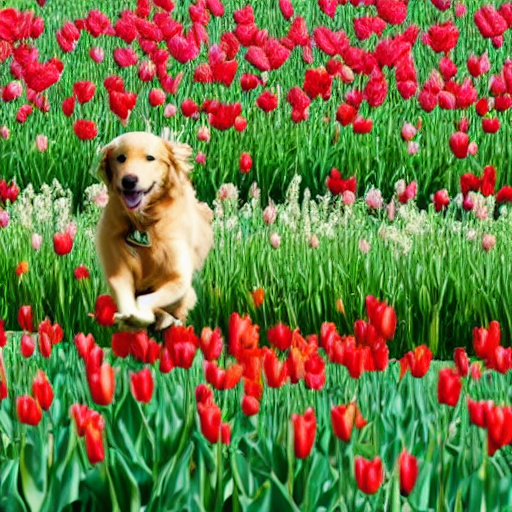

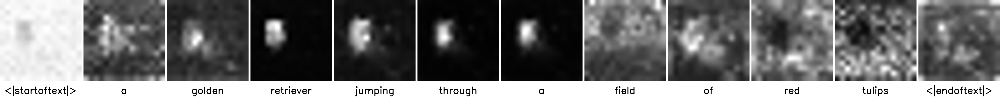

In [16]:
# Assuming 'tokenizer' and 'device' are defined in a previous setup cell
g_cpu = torch.Generator().manual_seed(42)

prompts = ["A golden retriever jumping through a field of red tulips"]

# The call is now direct, without a prefix.
controller = AttentionStore()

# This call remains the same, assuming you have updated the DEFINITION of
# run_and_display to call text2image_ldm_stable internally.
image, x_t = run_and_display(prompts, controller, latent=None, run_baseline=False, generator=g_cpu)

# MODIFIED: Added required 'tokenizer' and 'prompts' arguments.
show_cross_attention(controller,
                     res=16,
                     from_where=("up", "down"),
                     tokenizer=tokenizer,
                     prompts=prompts)

Generating baseline source image...


  0%|          | 0/35 [00:00<?, ?it/s]

Generating with Strategy A: Replace on down+mid blocks...


  0%|          | 0/35 [00:00<?, ?it/s]

Generating with Strategy B: Refine on up+mid blocks...


  0%|          | 0/35 [00:00<?, ?it/s]

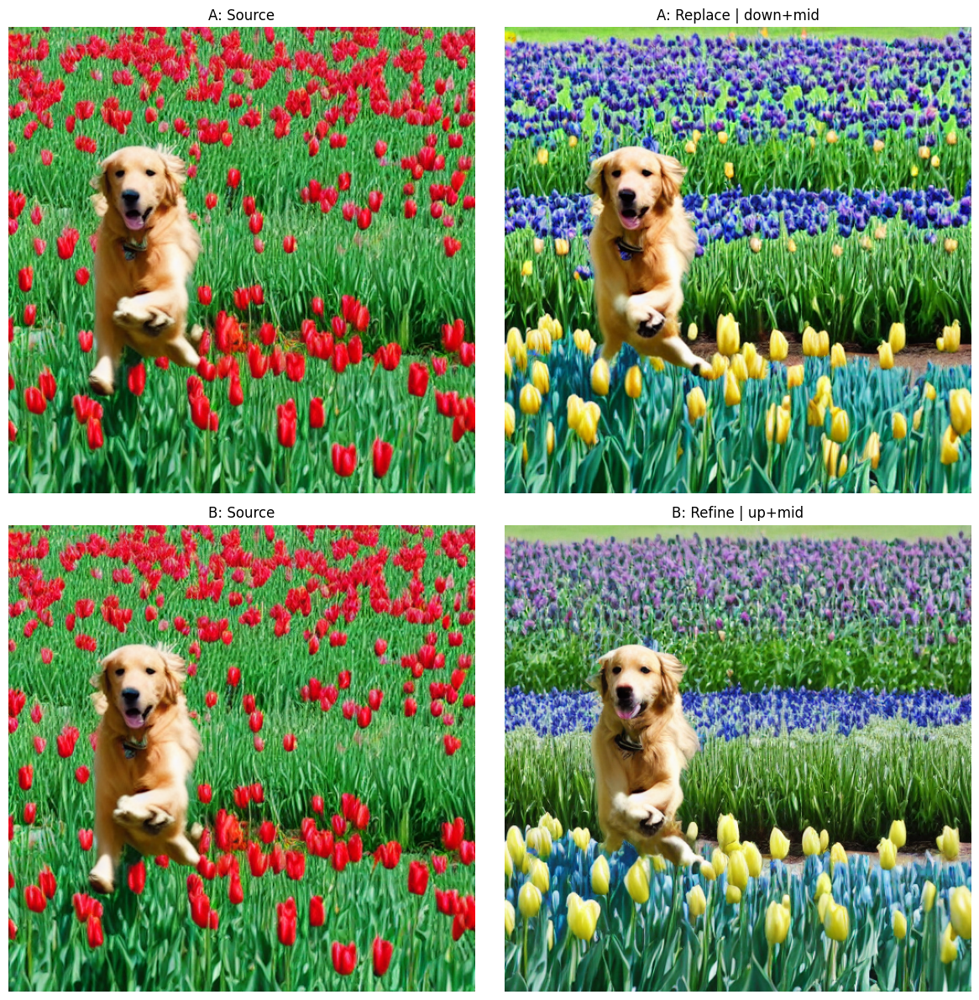

In [17]:
# Define the prompts
src_prompt = "A golden retriever jumping through a field of red tulips"
tgt_prompt = "A golden retriever jumping through a field of blue tulips"
prompts = [src_prompt, tgt_prompt]

# Generate a fixed latent vector to ensure a fair comparison
g_cpu = torch.Generator().manual_seed(42)
latent = torch.randn(
    (1, ldm_stable.unet.config.in_channels, 512 // 8, 512 // 8),
    generator=g_cpu,
).to(device, dtype=torch_dtype)

# --- Generate the baseline image for the source prompt ---
print("Generating baseline source image...")
controller_src = EmptyControl()
images_src, _ = text2image_ldm_stable(ldm_stable, [src_prompt], controller_src, latent=latent, num_inference_steps=35, guidance_scale=6.5, generator=g_cpu)
img_src = images_src[0]


# --- Strategy A: Replace on "down" and "mid" blocks ---
print("Generating with Strategy A: Replace on down+mid blocks...")
# MODIFIED: Re-introduced the 'edit_layers' parameter.
controller_a = AttentionRefine(
    prompts,
    num_steps=35,
    cross_replace_steps=.8,
    self_replace_steps=0.0,
    tokenizer=tokenizer,
    device=device,
    edit_layers=["down", "mid"]  # <-- Restored this line
)
images_a, _ = text2image_ldm_stable(ldm_stable, prompts, controller_a, latent=latent, num_inference_steps=35, guidance_scale=6.5, generator=g_cpu)
imgA_tgt = images_a[1]


# --- Strategy B: Refine on "up" and "mid" blocks ---
print("Generating with Strategy B: Refine on up+mid blocks...")
# MODIFIED: Re-introduced the 'edit_layers' parameter.
controller_b = AttentionRefine(
    prompts,
    num_steps=35,
    cross_replace_steps=.8,
    self_replace_steps=0.0,
    tokenizer=tokenizer,
    device=device,
    edit_layers=["up", "mid"]  # <-- Restored this line
)
images_b, _ = text2image_ldm_stable(ldm_stable, prompts, controller_b, latent=latent, num_inference_steps=35, guidance_scale=6.5, generator=g_cpu)
imgB_tgt = images_b[1]


# --- Show side-by-side comparison ---
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
axes[0,0].imshow(img_src); axes[0,0].set_title("A: Source"); axes[0,0].axis("off")
axes[0,1].imshow(imgA_tgt); axes[0,1].set_title("A: Replace | down+mid"); axes[0,1].axis("off")
axes[1,0].imshow(img_src); axes[1,0].set_title("B: Source"); axes[1,0].axis("off")
axes[1,1].imshow(imgB_tgt); axes[1,1].set_title("B: Refine | up+mid"); axes[1,1].axis("off")
plt.tight_layout(); plt.show()

Generating baseline source image...


/Users/leo/Desktop/prompt-to-prompt/ptp_utils.py:100: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


  0%|          | 0/35 [00:00<?, ?it/s]

Generating with Reweighted Attention...


  0%|          | 0/35 [00:00<?, ?it/s]

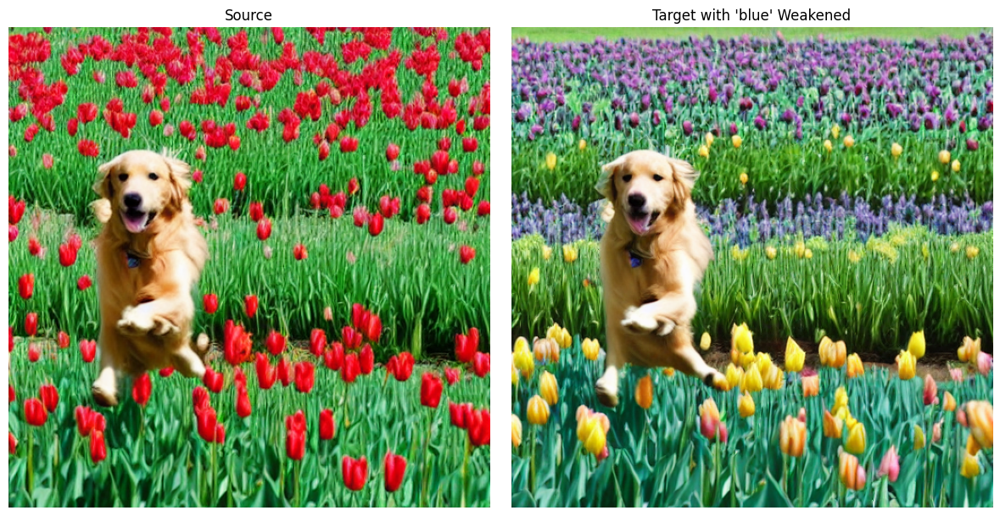

In [4]:
import matplotlib.pyplot as plt

# --- 1. Define Prompts and Common Settings ---
src_prompt = "A golden retriever jumping through a field of red tulips"
tgt_prompt = "A golden retriever jumping through a field of blue tulips"
prompts = [src_prompt, tgt_prompt]

num_steps = 35

# --- 2. Generate a fixed latent for a fair comparison ---
g_cpu = torch.Generator().manual_seed(42)
latent = torch.randn(
    (1, ldm_stable.unet.config.in_channels, 512 // 8, 512 // 8),
    generator=g_cpu,
).to(device, dtype=torch_dtype)

# --- 3. Generate the baseline source image ---
print("Generating baseline source image...")
controller_src = EmptyControl()
images_src, _ = text2image_ldm_stable(
    ldm_stable, [src_prompt], controller_src, latent=latent,
    num_inference_steps=num_steps, guidance_scale=7.5, generator=g_cpu
)
img_src = images_src[0]

# --- 4. Create the Reweight Controller ---
print("Generating with Reweighted Attention...")

# MODIFIED: Added tokenizer argument
equalizer = get_equalizer(prompts[1], ("blue",), (-1,), tokenizer)

# MODIFIED: Added tokenizer and device
base_controller = AttentionReplace(
    prompts,
    num_steps=num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.0,
    tokenizer=tokenizer,
    device=device,
    edit_layers=["down", "mid"] 
)

# MODIFIED: Added tokenizer and device
reweight_controller = AttentionReweight(
    prompts,
    num_steps=num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.0,
    equalizer=equalizer,
    controller=base_controller,
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable, prompts, reweight_controller, latent=latent,
    num_inference_steps=num_steps, guidance_scale=7.5, generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target with 'blue' Weakened"); axes[1].axis("off")
plt.tight_layout(); plt.show()

Generating baseline source image...


/Users/leo/Desktop/prompt-to-prompt/ptp_utils.py:100: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = latent.expand(batch_size,  model.unet.in_channels, height // 8, width // 8).to(model.device)


  0%|          | 0/35 [00:00<?, ?it/s]

Generating with Reweighted Attention...


  0%|          | 0/35 [00:00<?, ?it/s]

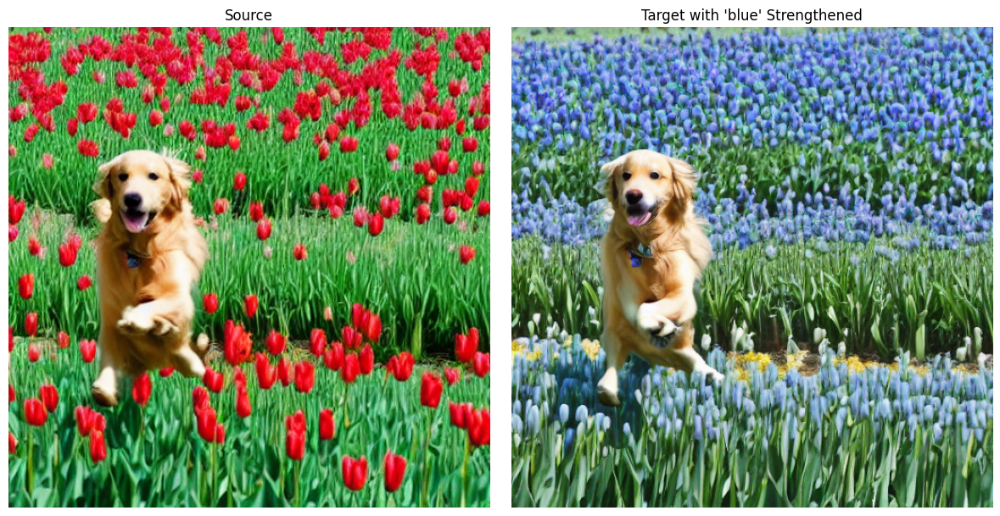

In [9]:
import matplotlib.pyplot as plt

# --- 1. Define Prompts and Common Settings ---
src_prompt = "A golden retriever jumping through a field of red tulips"
tgt_prompt = "A golden retriever jumping through a field of blue tulips"
prompts = [src_prompt, tgt_prompt]

num_steps = 35

# --- 2. Generate a fixed latent for a fair comparison ---
g_cpu = torch.Generator().manual_seed(42)
latent = torch.randn(
    (1, ldm_stable.unet.config.in_channels, 512 // 8, 512 // 8),
    generator=g_cpu,
).to(device, dtype=torch_dtype)

# --- 3. Generate the baseline source image ---
print("Generating baseline source image...")
controller_src = EmptyControl()
images_src, _ = text2image_ldm_stable(
    ldm_stable, [src_prompt], controller_src, latent=latent,
    num_inference_steps=num_steps, guidance_scale=7.5, generator=g_cpu
)
img_src = images_src[0]

# --- 4. Create the Reweight Controller ---
print("Generating with Reweighted Attention...")

# MODIFIED: Added tokenizer argument
equalizer = get_equalizer(prompts[1], ("blue",), (20,), tokenizer)

# MODIFIED: Added tokenizer and device
base_controller = AttentionReplace(
    prompts,
    num_steps=num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.0,
    tokenizer=tokenizer,
    device=device,
    edit_layers=["down", "mid"]  # <-- Restored this line
)

# MODIFIED: Added tokenizer and device
reweight_controller = AttentionReweight(
    prompts,
    num_steps=num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.0,
    equalizer=equalizer,
    controller=base_controller,
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable, prompts, reweight_controller, latent=latent,
    num_inference_steps=num_steps, guidance_scale=7.5, generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target with 'blue' Strengthened"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Cabin

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

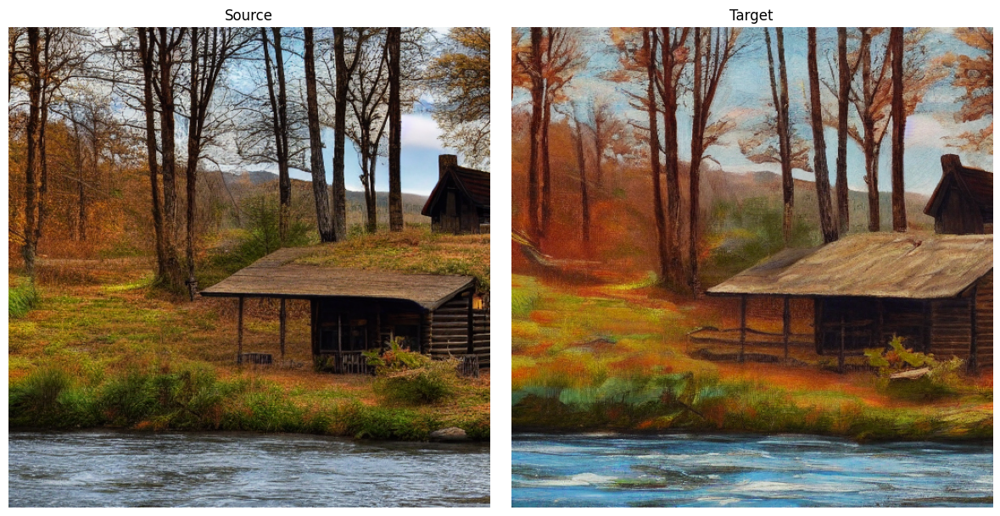

In [21]:
# --- 1. Define prompts ---
prompts = ["a cabin by the river", "a painting of a cabin by the river"]
num_steps = 30
seed = 888
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
# We use EmptyControl() for the source image generation as a placeholder controller.
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=6.5,
    generator=g_cpu
)
img_src = images_src[0]

# --- 3. Set up the AttentionRefine controller ---
# This controller will blend the attention maps of the original prompt with the new "painting" token.
refine_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.3,
    tokenizer=tokenizer,
    device=device
)

# --- 4. Generate the final image using the controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    refine_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=6.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]

# --- 5. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Forest

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

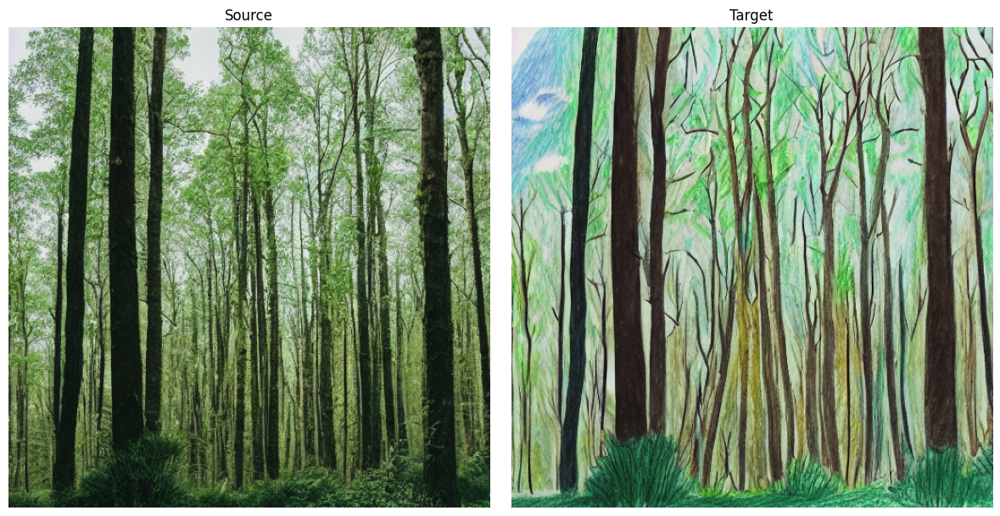

In [22]:
# --- 1. Define prompts and parameters ---
prompts = ["a photo of a forest", "Children drawing of a forest"]
num_steps = 30
seed = 42
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]

# --- 3. Create the base controller with layer-specific editing ---
# This controller receives the edit_layers argument.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.3,
    tokenizer=tokenizer,
    device=device,
    edit_layers=["up"] # Correct syntax for layer control
)

# --- 4. Create the Reweight controller to wrap the base controller ---
# Removed the 'device' argument as it's not a valid parameter.
equalizer = get_equalizer(prompts[1], ("Children", "drawing",), (2, 2,), tokenizer=tokenizer)

# This controller wraps the base_controller and does NOT take edit_layers.
reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.3,
    equalizer=equalizer,
    controller=base_controller, # Nesting the base controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller, # Using the final, nested controller
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]

# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Countryside

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

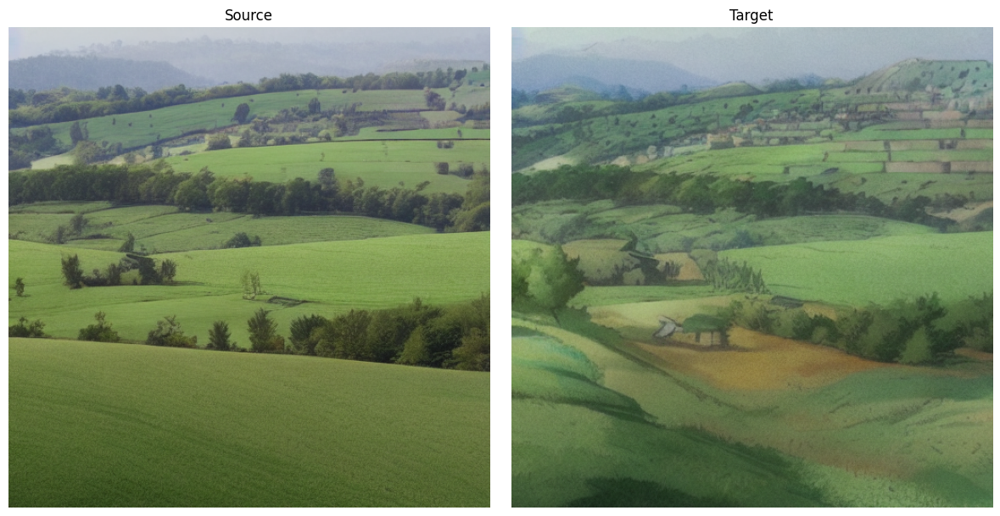

In [23]:
# --- 1. Define prompts ---
prompts = ["a picture of a countryside", "a picture of a countryside from an anime movie"]
num_steps = 30
seed = 42
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
# Use EmptyControl() for the initial image generation
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=6.5,
    generator=g_cpu
)
img_src = images_src[0]

# --- 3. Set up the AttentionRefine controller ---
# We are refining the prompt by adding the style "from an anime movie".
refine_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.1, # Using the value from the last successful run
    tokenizer=tokenizer,
    device=device
)

# --- 4. Generate the final image using the controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    refine_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=6.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]

# --- 5. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Cherry Tree

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

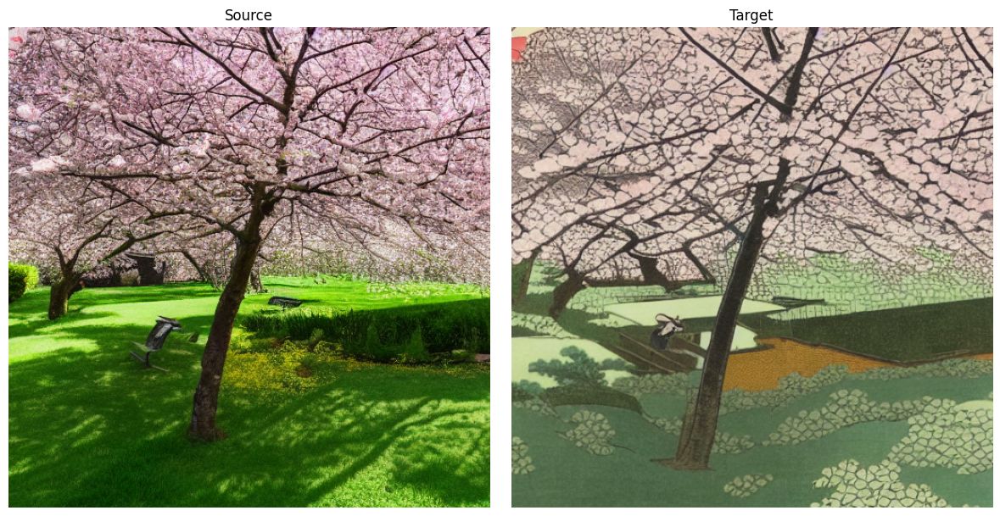

In [32]:
# --- 1. Define prompts for style change ---
prompts = [
    "a photo of a cherry tree in a garden in spring",
    "Ukiyo-e woodblock print of a cherry tree in a garden in spring"
]
num_steps = 35
seed = 42 # Using a new seed for a new image
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]

# --- 3. Create the base controller (AttentionRefine) ---
# This handles the addition of the new style words.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.1,
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap and strengthen the style ---
# We'll strongly amplify the key style words.
# As you pointed out, get_equalizer doesn't take a 'device' argument.
equalizer = get_equalizer(prompts[1], ("Ukiyo-e", "woodblock", "print"), (3.0, 3.0, 3.0), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.5,
    equalizer=equalizer,
    controller=base_controller, # Nesting the refine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]

# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Rainbow

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

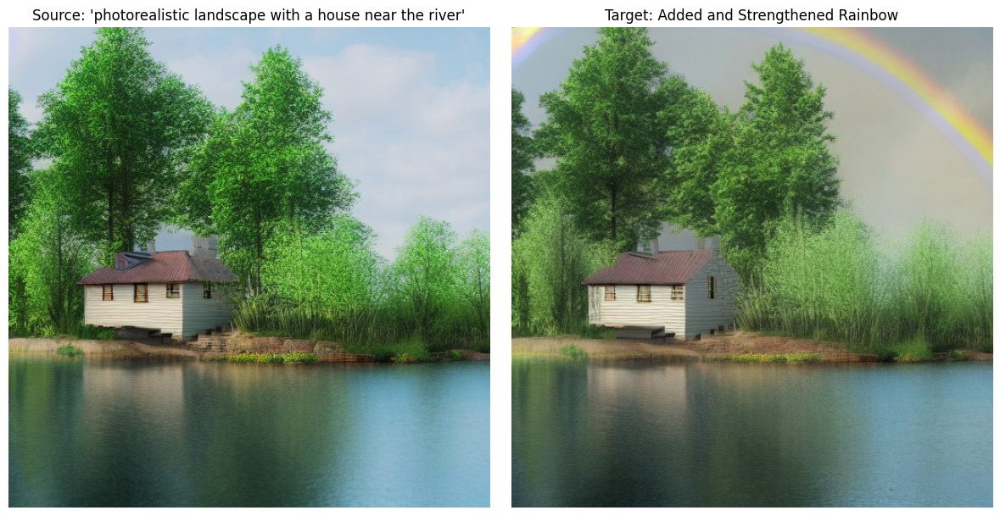

In [111]:
# --- 1. Define prompts and parameters ---
prompts = [
    "photorealistic landscape with a house near the river",
    "photorealistic landscape with a house near the river and a rainbow in the background"
]
num_steps = 30
seed = 42
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base controller (AttentionRefine) with layer-specific editing ---
# This handles adding the rainbow. The layer_preset="lowvram_down_mid"
# translates to editing only the "down" and "mid" attention blocks.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8, # Using a default value
    self_replace_steps=0.4, # Using a default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap the Refine controller ---
# This strengthens the "rainbow" concept by 2x.
equalizer = get_equalizer(prompts[1], ("rainbow",), (2.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.4,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionRefine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and Strengthened Rainbow"); axes[1].axis("off")
plt.tight_layout(); plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

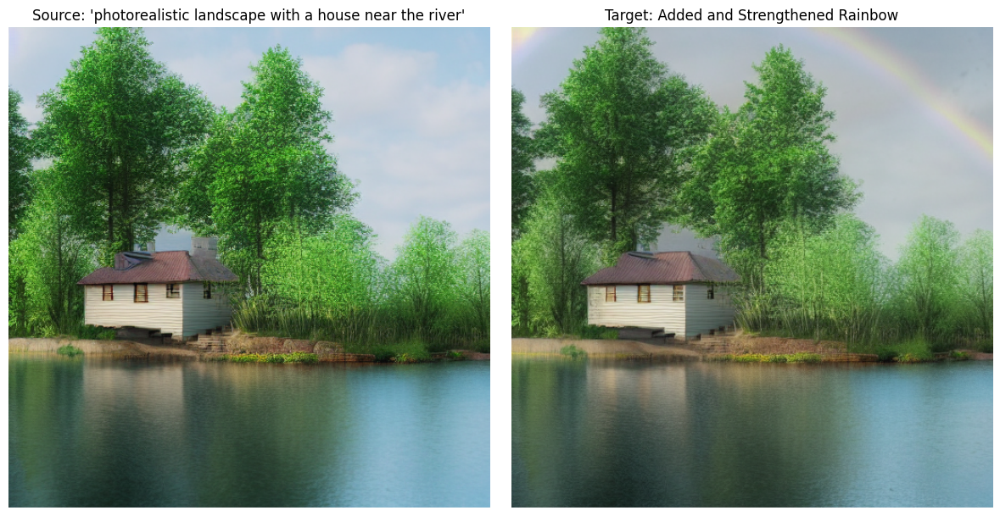

In [125]:
# --- 1. Define prompts and parameters ---
prompts = [
    "photorealistic landscape with a house near the river",
    "photorealistic landscape with a house near the river and a rainbow in the background"
]
num_steps = 30
seed = 42
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base controller (AttentionRefine) with layer-specific editing ---
# This handles adding the rainbow. The layer_preset="lowvram_down_mid"
# translates to editing only the "down" and "mid" attention blocks.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.7, # Using a default value
    self_replace_steps=0.5, # Using a default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap the Refine controller ---
# This strengthens the "rainbow" concept by 2x.
equalizer = get_equalizer(prompts[1], ("rainbow",), (1.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.7,
    self_replace_steps=0.5,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionRefine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and Strengthened Rainbow"); axes[1].axis("off")
plt.tight_layout(); plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

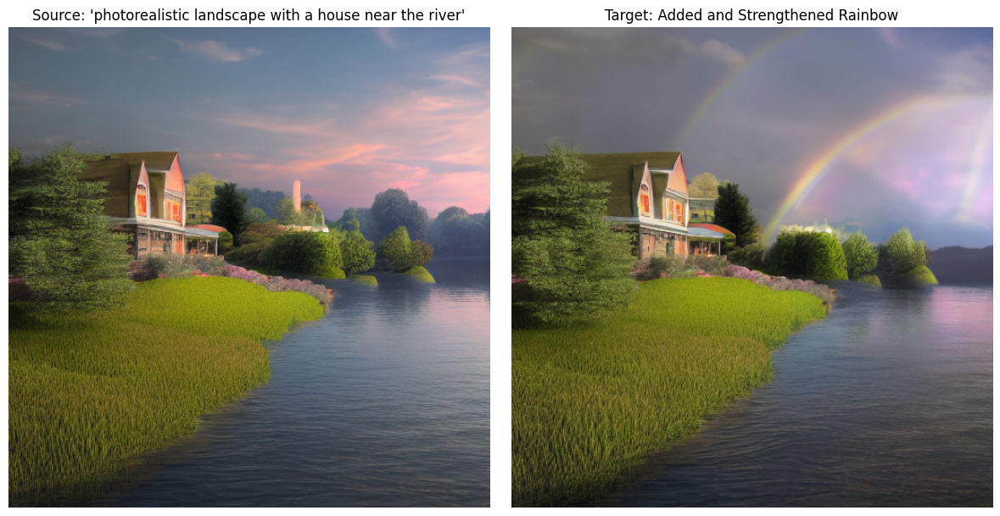

In [118]:
# --- 1. Define prompts and parameters ---
prompts = [
    "photorealistic landscape with a house near the river",
    "photorealistic landscape with a house near the river and a rainbow in the background"
]
num_steps = 30
seed = 420
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base controller (AttentionRefine) with layer-specific editing ---
# This handles adding the rainbow. The layer_preset="lowvram_down_mid"
# translates to editing only the "down" and "mid" attention blocks.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.7, # Using a default value
    self_replace_steps=0.5, # Using a default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap the Refine controller ---
# This strengthens the "rainbow" concept by 2x.
equalizer = get_equalizer(prompts[1], ("rainbow",), (1.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.7,
    self_replace_steps=0.5,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionRefine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and Strengthened Rainbow"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Teddy bear

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

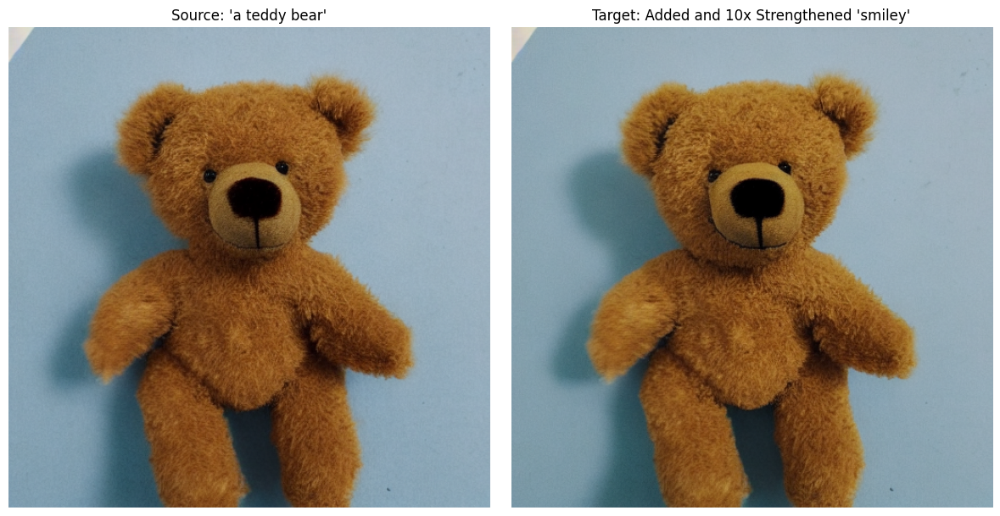

In [146]:
# --- 1. Define prompts and parameters ---
prompts = ["a teddy bear", "a smiley teddy bear"]
num_steps = 30
seed = 42 # Using seed 42 as requested
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base AttentionRefine controller ---
# This handles adding the word "smiley". No layer specification is used.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8, # Default value
    self_replace_steps=0.4, # Default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap and strengthen the base controller ---
# We'll use a very strong 10x weight for "smiley".
equalizer = get_equalizer(prompts[1], ("smiley",), (2.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.4,
    equalizer=equalizer,
    controller=base_controller, # Nesting the refine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and 10x Strengthened 'smiley'"); axes[1].axis("off")
plt.tight_layout(); plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

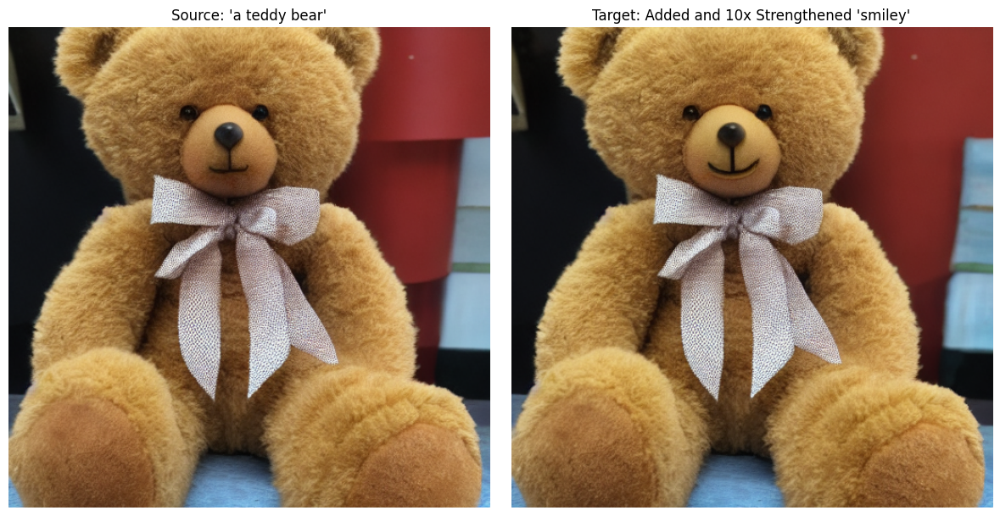

In [147]:
# --- 1. Define prompts and parameters ---
prompts = ["a teddy bear", "a smiley teddy bear"]
num_steps = 30
seed = 101 # Using seed 42 as requested
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base AttentionRefine controller ---
# This handles adding the word "smiley". No layer specification is used.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8, # Default value
    self_replace_steps=0.4, # Default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap and strengthen the base controller ---
# We'll use a very strong 10x weight for "smiley".
equalizer = get_equalizer(prompts[1], ("smiley",), (2.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.4,
    equalizer=equalizer,
    controller=base_controller, # Nesting the refine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and 10x Strengthened 'smiley'"); axes[1].axis("off")
plt.tight_layout(); plt.show()

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

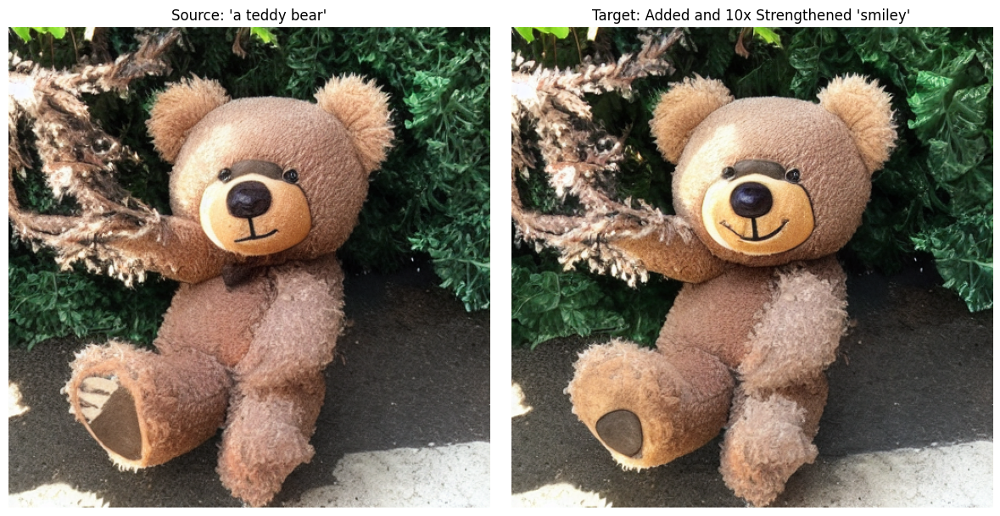

In [149]:
# --- 1. Define prompts and parameters ---
prompts = ["a teddy bear", "a smiley teddy bear"]
num_steps = 30
seed = 8888 # Using seed 42 as requested
g_cpu = torch.Generator().manual_seed(seed)

# --- 2. Generate the source image and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_src = images_src[0]


# --- 3. Create the base AttentionRefine controller ---
# This handles adding the word "smiley". No layer specification is used.
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=0.8, # Default value
    self_replace_steps=0.4, # Default value
    tokenizer=tokenizer,
    device=device
)

# --- 4. Create the Reweight controller to wrap and strengthen the base controller ---
# We'll use a very strong 10x weight for "smiley".
equalizer = get_equalizer(prompts[1], ("smiley",), (2.0,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=0.8,
    self_replace_steps=0.4,
    equalizer=equalizer,
    controller=base_controller, # Nesting the refine controller
    tokenizer=tokenizer,
    device=device
)

# --- 5. Generate the final image using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5, # Using guidance 7.5 as requested
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 6. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title(f"Source: '{prompts[0]}'"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title(f"Target: Added and 10x Strengthened 'smiley'"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Sculpture

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

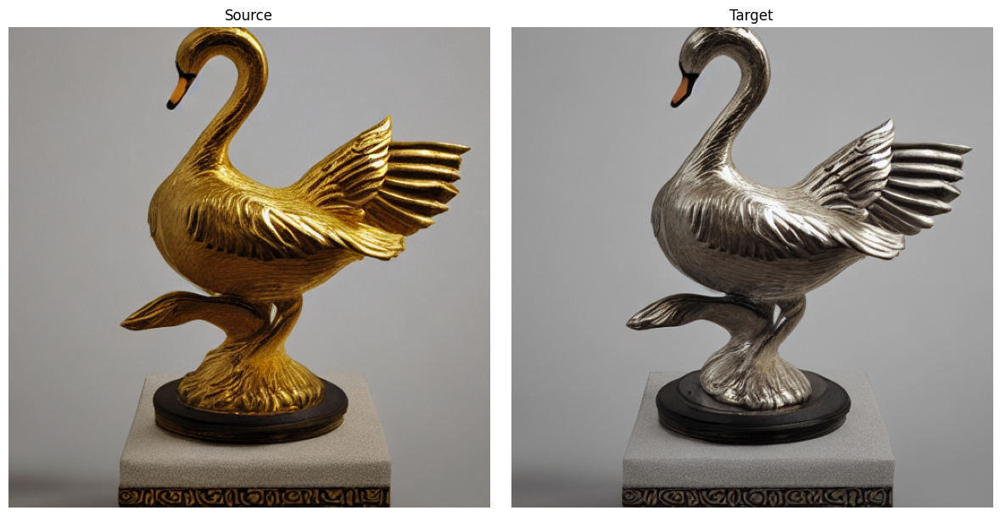

In [45]:
# --- 1. Define editable parameters ---
cross_replace_steps = 0.8
self_replace_steps = 0.4
reweight_strength = 1.0 # Set to 1.0 for a neutral effect, change to >1 to strengthen, <1 to weaken

# --- 2. Define prompts for replacement ---
prompts = [
    "a gold sculpture of a swan on a pedestal",
    "an silver sculpture of a swan on a pedestal"
]
num_steps = 35
seed = 987 # Using a new seed for a new image
g_cpu = torch.Generator().manual_seed(seed)

# --- 3. Generate the source image (glass) and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 4. Create the base controller (AttentionReplace) ---
# This controller will replace "glass" with "ice".
base_controller = AttentionReplace(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps, # Using the variable from the top
    self_replace_steps=self_replace_steps,   # Using the variable from the top
    tokenizer=tokenizer,
    device=device
)

# --- 5. Create the Reweight controller to wrap the base controller ---
# I'm using the rule you taught me: get_equalizer does not take a 'device' argument.
equalizer = get_equalizer(prompts[1], ("ice",), (reweight_strength,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps,
    self_replace_steps=self_replace_steps,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionReplace controller
    tokenizer=tokenizer,
    device=device
)

# --- 6. Generate the final image (ice) using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 7. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

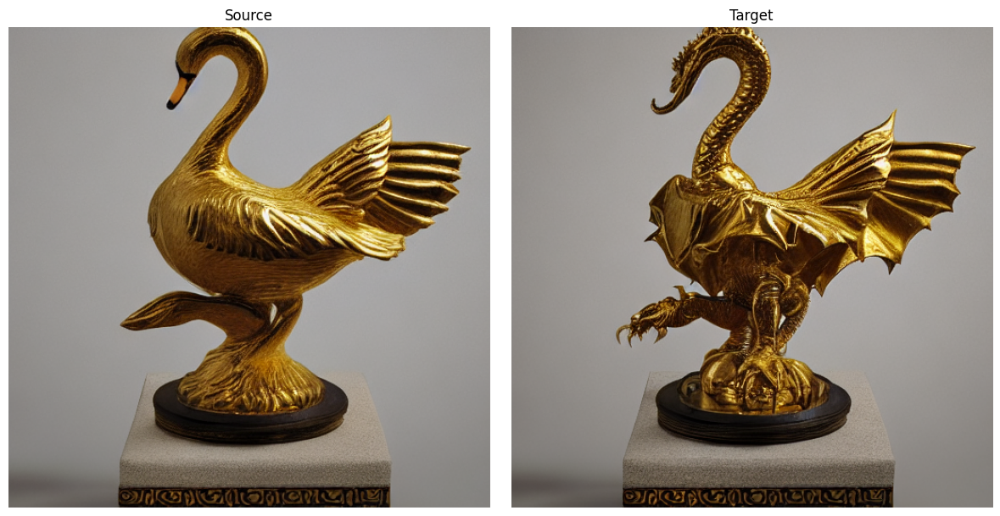

In [52]:
# --- 1. Define editable parameters ---
cross_replace_steps = 0.8
self_replace_steps = 0.5
reweight_strength = 1.0 # Set to 1.0 for a neutral effect, change to >1 to strengthen, <1 to weaken

# --- 2. Define prompts for replacement ---
prompts = [
    "a gold sculpture of a swan on a pedestal",
    "a gold sculpture of a dragon on a pedestal"
]
num_steps = 35
seed = 987 # Using a new seed for a new image
g_cpu = torch.Generator().manual_seed(seed)

# --- 3. Generate the source image (glass) and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 4. Create the base controller (AttentionReplace) ---
# This controller will replace "glass" with "ice".
base_controller = AttentionRefine(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps, # Using the variable from the top
    self_replace_steps=self_replace_steps,   # Using the variable from the top
    tokenizer=tokenizer,
    device=device
)

# --- 5. Create the Reweight controller to wrap the base controller ---
# I'm using the rule you taught me: get_equalizer does not take a 'device' argument.
equalizer = get_equalizer(prompts[1], ("ice",), (reweight_strength,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps,
    self_replace_steps=self_replace_steps,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionReplace controller
    tokenizer=tokenizer,
    device=device
)

# --- 6. Generate the final image (ice) using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 7. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()

# Sunflowers

  0%|          | 0/35 [00:00<?, ?it/s]

  0%|          | 0/35 [00:00<?, ?it/s]

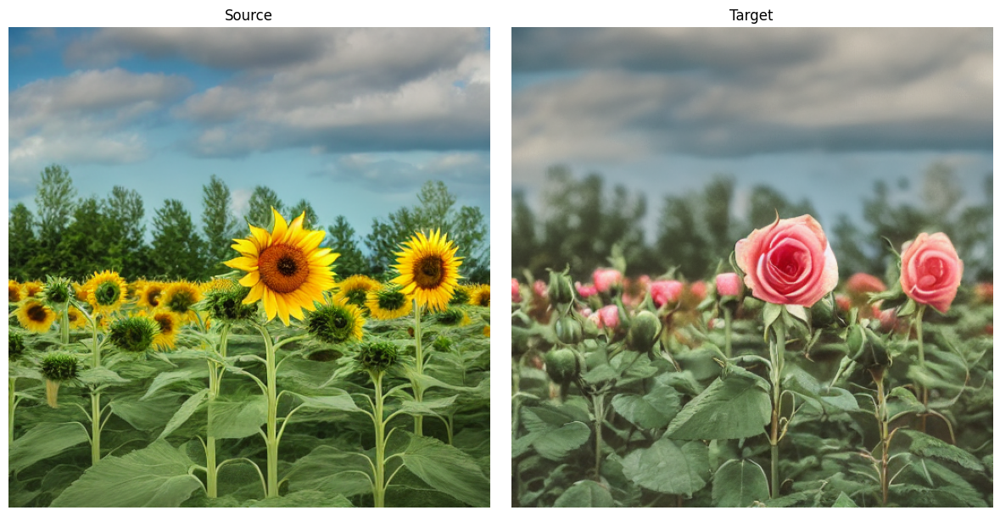

In [57]:
# --- 1. Define editable parameters ---
cross_replace_steps = 0.8
self_replace_steps = 0.4
reweight_strength = 1.0 # Set to 1.0 for a neutral effect, change to >1 to strengthen, <1 to weaken

# --- 2. Define prompts for replacement ---
prompts = [
    "a photorealistic photo of a sunflower in a field",
    "a photorealistic photo of a rose in a field"
]
num_steps = 35
seed = 1122 # Using a new seed for a new image
g_cpu = torch.Generator().manual_seed(seed)

# --- 3. Generate the source image (sunflower) and latent ---
images_src, latent = text2image_ldm_stable(
    ldm_stable,
    [prompts[0]],
    controller=EmptyControl(),
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_src = images_src[0]


# --- 4. Create the base controller (AttentionReplace) ---
# This controller will replace "sunflower" with "rose".
base_controller = AttentionReplace(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps, # Using the variable from the top
    self_replace_steps=self_replace_steps,   # Using the variable from the top
    tokenizer=tokenizer,
    device=device
)

# --- 5. Create the Reweight controller to wrap the base controller ---
# This targets "rose" with the reweight strength.
equalizer = get_equalizer(prompts[1], ("rose",), (reweight_strength,), tokenizer=tokenizer)

reweight_controller = AttentionReweight(
    prompts,
    num_steps,
    cross_replace_steps=cross_replace_steps,
    self_replace_steps=self_replace_steps,
    equalizer=equalizer,
    controller=base_controller, # Nesting the AttentionReplace controller
    tokenizer=tokenizer,
    device=device
)

# --- 6. Generate the final image (rose) using the combined controller ---
images_tgt, _ = text2image_ldm_stable(
    ldm_stable,
    prompts,
    reweight_controller,
    latent=latent,
    num_inference_steps=num_steps,
    guidance_scale=7.5,
    generator=g_cpu
)
img_tgt = images_tgt[1]


# --- 7. Show side-by-side comparison ---
fig, axes = plt.subplots(1, 2, figsize=(12, 6))
axes[0].imshow(img_src); axes[0].set_title("Source"); axes[0].axis("off")
axes[1].imshow(img_tgt); axes[1].set_title("Target"); axes[1].axis("off")
plt.tight_layout(); plt.show()